<a href="https://colab.research.google.com/github/rebeccagio/object_detection/blob/master/Object_detection_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
!nvidia-smi

Thu Jul 23 18:30:17 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.51.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8    11W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [5]:
!git clone https://github.com/fizyr/keras-retinanet.git

Cloning into 'keras-retinanet'...
remote: Enumerating objects: 5862, done.
remote: Total 5862 (delta 0), reused 0 (delta 0), pack-reused 5862
Receiving objects: 100% (5862/5862), 13.40 MiB | 8.21 MiB/s, done.
Resolving deltas: 100% (3948/3948), done.


In [9]:
!pip3 install keras==2.3.1

In [10]:
%cd keras-retinanet/

!pip install .

[Errno 2] No such file or directory: 'keras-retinanet/'
/content/keras-retinanet
Processing /content/keras-retinanet
  Created wheel for keras-retinanet: filename=keras_retinanet-0.5.1-cp36-cp36m-linux_x86_64.whl size=170786 sha256=c38e80ab7c08a2ca9fecc012eea5eef7400538717d5906f9e3ab9ac1d9bc3a57
  Stored in directory: /root/.cache/pip/wheels/b2/9f/57/cb0305f6f5a41fc3c11ad67b8cedfbe9127775b563337827ba
Successfully built keras-retinanet
  Found existing installation: keras-retinanet 0.5.1
    Uninstalling keras-retinanet-0.5.1:
      Successfully uninstalled keras-retinanet-0.5.1


In [11]:
!python setup.py build_ext --inplace

running build_ext
cythoning keras_retinanet/utils/compute_overlap.pyx to keras_retinanet/utils/compute_overlap.c
/usr/local/lib/python3.6/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/keras-retinanet/keras_retinanet/utils/compute_overlap.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'keras_retinanet.utils.compute_overlap' extension
creating build
creating build/temp.linux-x86_64-3.6
creating build/temp.linux-x86_64-3.6/keras_retinanet
creating build/temp.linux-x86_64-3.6/keras_retinanet/utils
x86_64-linux-gnu-gcc -pthread -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/include/python3.6m -I/usr/local/lib/python3.6/dist-packages/numpy/core/include -c keras_retinanet/utils/compute_overlap.c -o build/temp.linux-x86_64-3.6/keras_retinanet/utils/compute_over

In [12]:
!pip install gdown
!pip install tensorflow-gpu

     |████████████████████████████████| 516.2MB 16kB/s 


In [14]:
import numpy as np
import tensorflow as tf
import pandas as pd
import pandas.util.testing as tm
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters
from sklearn.model_selection import train_test_split
import urllib
import os
import csv
import cv2
import time
import json
from PIL import Image



from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

In [15]:
#downloads json file from public google drive link id 
!gdown --id 1nH91hBX43AhG4AEPHSPHRSCKq95Tko0O --output test_05_json.json

Downloading...
From: https://drive.google.com/uc?id=1nH91hBX43AhG4AEPHSPHRSCKq95Tko0O
To: /content/keras-retinanet/test_05_json.json
100% 9.73k/9.73k [00:00<00:00, 9.13MB/s]


In [16]:
#creates a folder called "snapshots"
os.makedirs("snapshots", exist_ok=True)

In [17]:
#pretrained model is downloaded into "snapshots"
!gdown --id 1wPgOBoSks6bTIs9RzNvZf6HWROkciS8R --output snapshots/resnet50_csv_10.h5

Downloading...
From: https://drive.google.com/uc?id=1wPgOBoSks6bTIs9RzNvZf6HWROkciS8R
To: /content/keras-retinanet/snapshots/resnet50_csv_10.h5
249MB [00:02, 84.8MB/s]


In [18]:
#loads json files into pandas dataframe, we use lines to specify that the file has multiple lines
table_df = pd.read_json('test_05_json.json', lines=True)
print(table_df)

                                              content  ... extras
0   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
1   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
2   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
3   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
4   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
5   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
6   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
7   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
8   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
9   https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
10  https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
11  https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
12  https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
13  https://raw.githubusercontent.com/rebeccagio/o...  ...    NaN
14  https:

In [19]:
os.makedirs("mat_table", exist_ok=True)

In [20]:
#dictionary 
dataset = dict()
dataset["image_name"] = list()
dataset["x_min"] = list()
dataset["y_min"] = list()
dataset["x_max"] = list()
dataset["y_max"] = list()
dataset["class_name"] = list()

counter = 0
for index, row in table_df.iterrows():
    #download image, take content 
    img = urllib.request.urlopen(row["content"])
    img = Image.open(img)
    img = img.convert('RGB')
    img.save(f'mat_table/table_{counter}.jpeg', "JPEG")
    
    dataset["image_name"].append(f'mat_table/table_{counter}.jpeg')
    
    data = row["annotation"]
    print(data)

    width = data[0]["imageWidth"]
    height = data[0]["imageHeight"]

    dataset["x_min"].append(int(round(data[0]["points"][0]["x"])))
    dataset["y_min"].append(int(round(data[0]["points"][0]["y"])))
    dataset["x_max"].append(int(round(data[0]["points"][1]["x"])))
    dataset["y_max"].append(int(round(data[0]["points"][1]["y"])))
    dataset["class_name"].append("table")
    
    counter += 1
print("Downloaded {} table images.".format(counter))

[{'label': ['table'], 'notes': '', 'points': [{'x': 437, 'y': 270}, {'x': 979, 'y': 812}], 'imageWidth': 1920, 'imageHeight': 1080}]
[{'label': ['table'], 'notes': '', 'points': [{'x': 692, 'y': 16}, {'x': 1237, 'y': 552}], 'imageWidth': 1920, 'imageHeight': 1080}]
[{'label': ['table'], 'notes': '', 'points': [{'x': 41, 'y': 503}, {'x': 824, 'y': 872}], 'imageWidth': 875, 'imageHeight': 875}]
[{'label': ['table'], 'notes': '', 'points': [{'x': 196, 'y': 264}, {'x': 449, 'y': 474}], 'imageWidth': 563, 'imageHeight': 563}]
[{'label': ['table'], 'notes': '', 'points': [{'x': 108, 'y': 51}, {'x': 272, 'y': 141}], 'imageWidth': 272, 'imageHeight': 272}]
[{'label': ['table'], 'notes': '', 'points': [{'x': 52, 'y': 42}, {'x': 256, 'y': 191}], 'imageWidth': 315, 'imageHeight': 315}]
[{'label': ['table'], 'notes': '', 'points': [{'x': 1, 'y': 42}, {'x': 454, 'y': 325}], 'imageWidth': 521, 'imageHeight': 521}]
[{'label': ['table'], 'notes': '', 'points': [{'x': 189, 'y': 100}, {'x': 330, 'y': 24

In [21]:
df = pd.DataFrame(dataset)
df.head()

,image_name,x_min,y_min,x_max,y_max,class_name
0,mat_table/table_0.jpeg,437,270,979,812,table
1,mat_table/table_1.jpeg,692,16,1237,552,table
2,mat_table/table_2.jpeg,41,503,824,872,table
3,mat_table/table_3.jpeg,196,264,449,474,table
4,mat_table/table_4.jpeg,108,51,272,141,table


In [22]:
def show_image_objects(image_row):

  img_path = image_row.image_name
  box = [
    image_row.x_min, image_row.y_min, image_row.x_max, image_row.y_max
  ] 
  print(box)
  image = read_image_bgr(img_path)

  draw = image.copy()

  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
  draw_box(draw, box, color=(255, 255, 0))

  plt.axis('off')
  plt.imshow(draw)
  plt.show()

[36, 80, 473, 234]


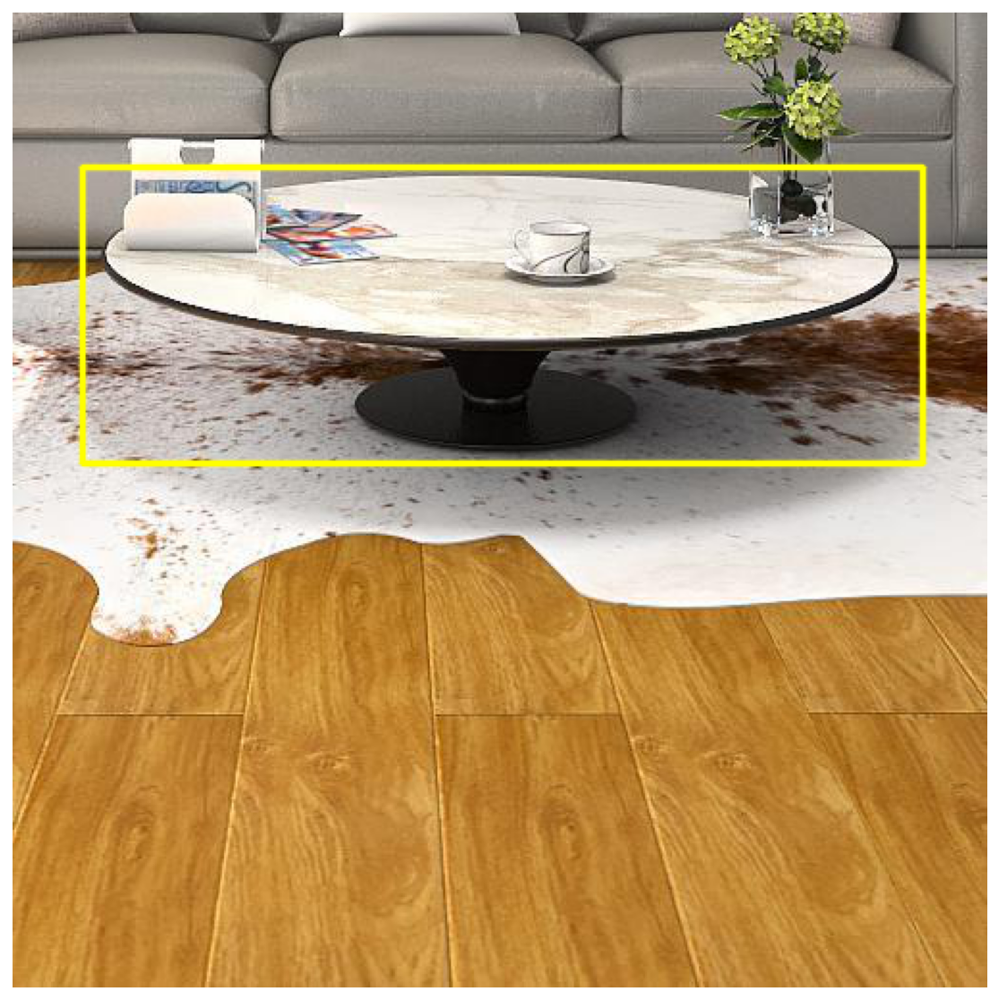

In [23]:
show_image_objects(df.iloc[20])

[66, 199, 583, 439]


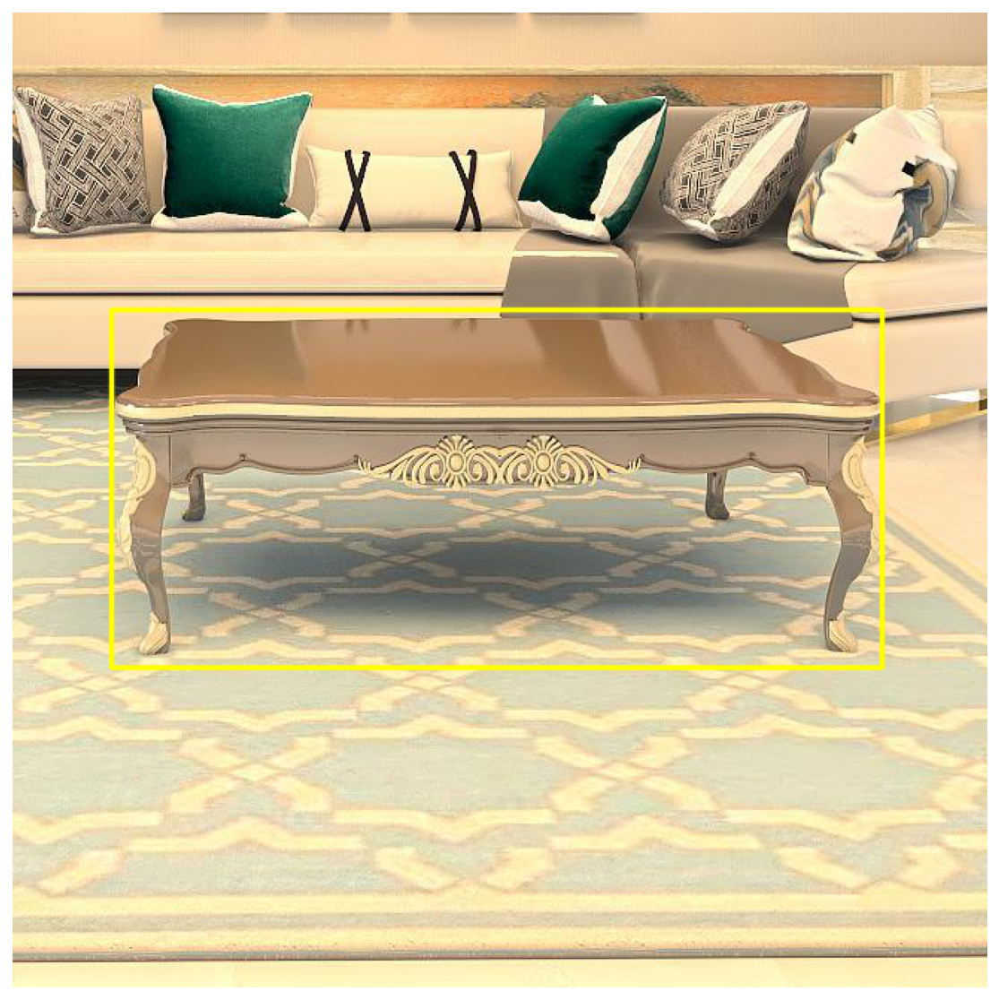

In [24]:
show_image_objects(df.iloc[35])

#Pre-processing


In [25]:
train_df, test_df = train_test_split(
  df, 
  test_size=0.8, 
  random_state=RANDOM_SEED
)

In [26]:
train_df.shape

(7, 6)

In [27]:
ANNOTATIONS_FILE = 'annotations.csv'
CLASSES_FILE = 'classes.csv'

In [28]:
train_df.to_csv(ANNOTATIONS_FILE, index=False, header=None)

In [29]:
classes = set(['table'])

with open(CLASSES_FILE, 'w') as f:
  for i, line in enumerate(sorted(classes)):
    f.write('{},{}\n'.format(line,i))

In [30]:
!head classes.csv

table,0


In [31]:
!head annotations.csv

mat_table/table_22.jpeg,2,36,490,407,table
mat_table/table_18.jpeg,57,58,209,242,table
mat_table/table_20.jpeg,36,80,473,234,table
mat_table/table_7.jpeg,189,100,330,240,table
mat_table/table_14.jpeg,15,61,542,402,table
mat_table/table_28.jpeg,189,432,650,642,table
mat_table/table_38.jpeg,87,256,568,474,table


#Training

In [32]:
PRETRAINED_MODEL = './snapshots/_pretrained_model.h5'

URL_MODEL = 'https://github.com/fizyr/keras-retinanet/releases/download/0.5.1/resnet50_coco_best_v2.1.0.h5'
urllib.request.urlretrieve(URL_MODEL, PRETRAINED_MODEL)

print('Downloaded pretrained model to ' + PRETRAINED_MODEL)

Downloaded pretrained model to ./snapshots/_pretrained_model.h5


In [40]:
!keras_retinanet/bin/train.py --freeze-backbone --random-transform --weights {PRETRAINED_MODEL} --batch-size 8 --steps 500 --epochs 10 csv annotations.csv classes.csv

Using TensorFlow backend.
Creating model, this may take a second...
2020-07-23 18:41:36.628625: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-07-23 18:41:36.633755: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-07-23 18:41:36.634289: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1561] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2020-07-23 18:41:36.634562: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
2020-07-23 18:41:36.636296: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcublas.so.10
2020-07

#Loading the Trained Model

In [41]:
!ls snapshots

_pretrained_model.h5  resnet50_csv_04.h5  resnet50_csv_08.h5
resnet50_csv_01.h5    resnet50_csv_05.h5  resnet50_csv_09.h5
resnet50_csv_02.h5    resnet50_csv_06.h5  resnet50_csv_10.h5
resnet50_csv_03.h5    resnet50_csv_07.h5


In [42]:
model_path = os.path.join('snapshots', sorted(os.listdir('snapshots'), reverse=True)[0])
print(model_path)

model = models.load_model(model_path, backbone_name='resnet50')
model = models.convert_model(model)

labels_to_names = pd.read_csv(CLASSES_FILE, header=None).T.loc[0].to_dict()

snapshots/resnet50_csv_10.h5
tracking <tf.Variable 'Variable:0' shape=(9, 4) dtype=float32, numpy=
array([[-22.627417, -11.313708,  22.627417,  11.313708],
       [-28.50876 , -14.25438 ,  28.50876 ,  14.25438 ],
       [-35.918785, -17.959393,  35.918785,  17.959393],
       [-16.      , -16.      ,  16.      ,  16.      ],
       [-20.158737, -20.158737,  20.158737,  20.158737],
       [-25.398417, -25.398417,  25.398417,  25.398417],
       [-11.313708, -22.627417,  11.313708,  22.627417],
       [-14.25438 , -28.50876 ,  14.25438 ,  28.50876 ],
       [-17.959393, -35.918785,  17.959393,  35.918785]], dtype=float32)> anchors
tracking <tf.Variable 'Variable:0' shape=(9, 4) dtype=float32, numpy=
array([[-45.254833, -22.627417,  45.254833,  22.627417],
       [-57.01752 , -28.50876 ,  57.01752 ,  28.50876 ],
       [-71.83757 , -35.918785,  71.83757 ,  35.918785],
       [-32.      , -32.      ,  32.      ,  32.      ],
       [-40.317474, -40.317474,  40.317474,  40.317474],
       [

#Predictions

In [43]:
def predict(image):
  image = preprocess_image(image.copy())
  
  image, scale = resize_image(image)

  boxes, scores, labels = model.predict_on_batch(
    np.expand_dims(image, axis=0)
  )

  boxes /= scale

  return boxes, scores, labels

In [44]:
THRES_SCORE = 0.6

def draw_detections(image, boxes, scores, labels):
  for box, score, label in zip(boxes[0], scores[0], labels[0]):
    if score < THRES_SCORE:
        break

    color = label_color(label)

    b = box.astype(int)
    draw_box(image, b, color=color)

    caption = "{} {:.3f}".format(labels_to_names[label], score)
    draw_caption(image, b, caption)

In [45]:
def show_detected_objects(image_row):
  img_path = image_row.image_name
  
  image = read_image_bgr(img_path)

  boxes, scores, labels = predict(image)

  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

  true_box = [
    image_row.x_min, image_row.y_min, image_row.x_max, image_row.y_max
  ]
  draw_box(draw, true_box, color=(255, 255, 0))

  draw_detections(draw, boxes, scores, labels)

  plt.axis('off')
  plt.imshow(draw)
  plt.show()

In [46]:
test_df.head(n=35)

,image_name,x_min,y_min,x_max,y_max,class_name
33,mat_table/table_33.jpeg,66,77,241,229,table
36,mat_table/table_36.jpeg,134,406,1026,1016,table
4,mat_table/table_4.jpeg,108,51,272,141,table
13,mat_table/table_13.jpeg,44,68,416,293,table
30,mat_table/table_30.jpeg,102,242,407,407,table
26,mat_table/table_26.jpeg,1,130,245,442,table
6,mat_table/table_6.jpeg,1,42,454,325,table
27,mat_table/table_27.jpeg,3,53,466,376,table
24,mat_table/table_24.jpeg,27,64,290,296,table
15,mat_table/table_15.jpeg,78,68,431,371,table


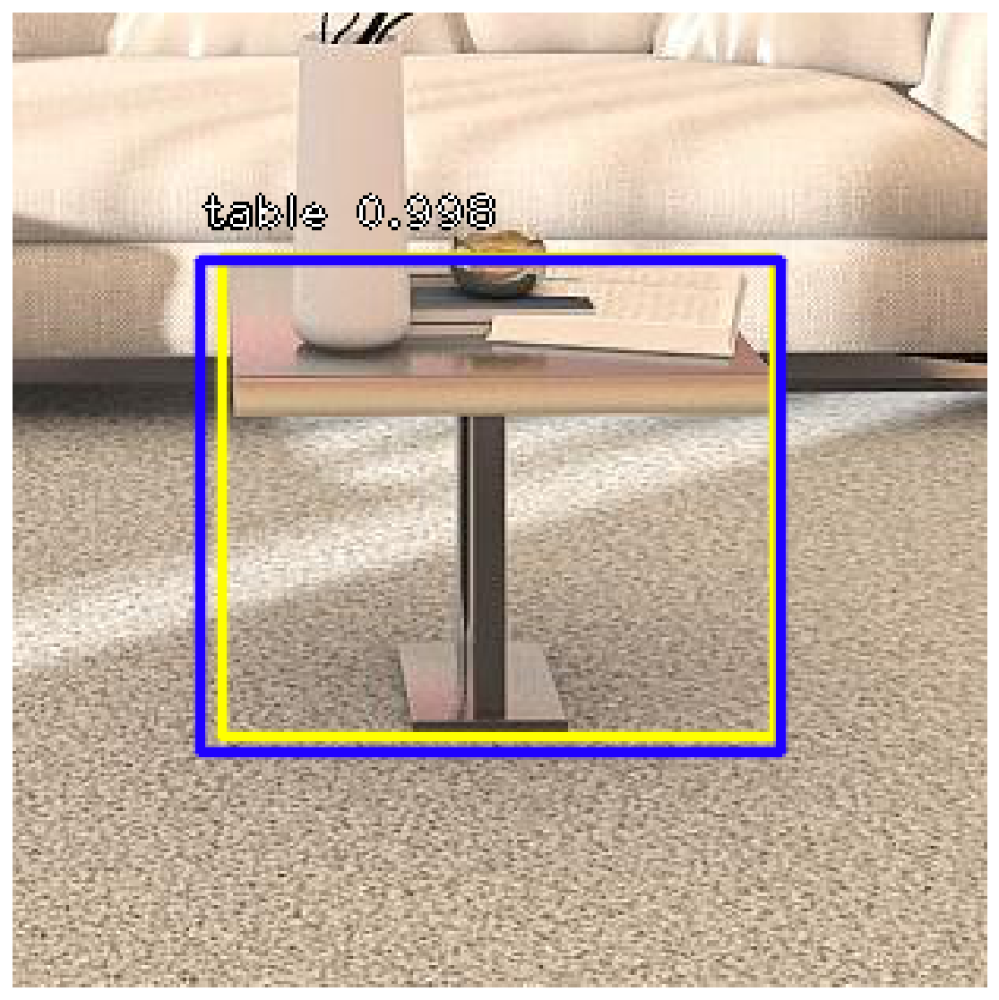

In [47]:
show_detected_objects(test_df.iloc[0])

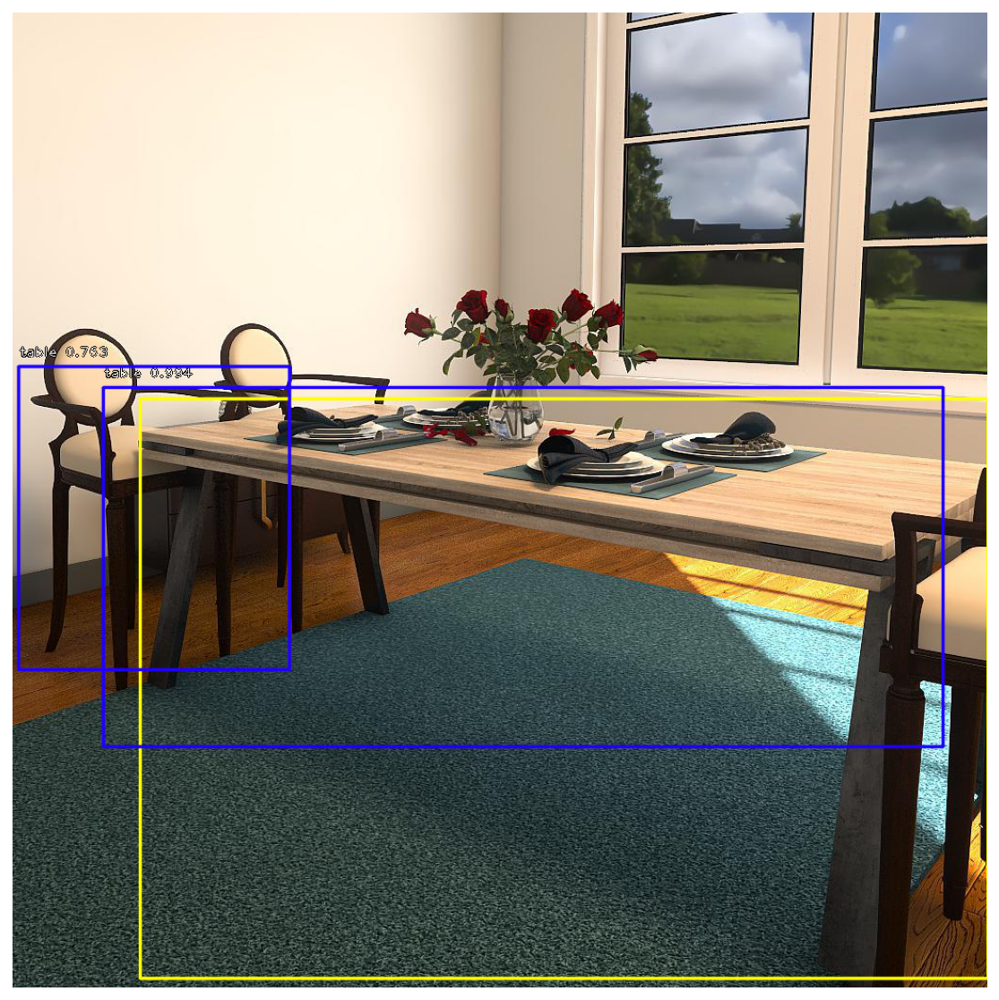

In [48]:
# current issue, this should be displaying a prediction percentage

show_detected_objects(test_df.iloc[1])

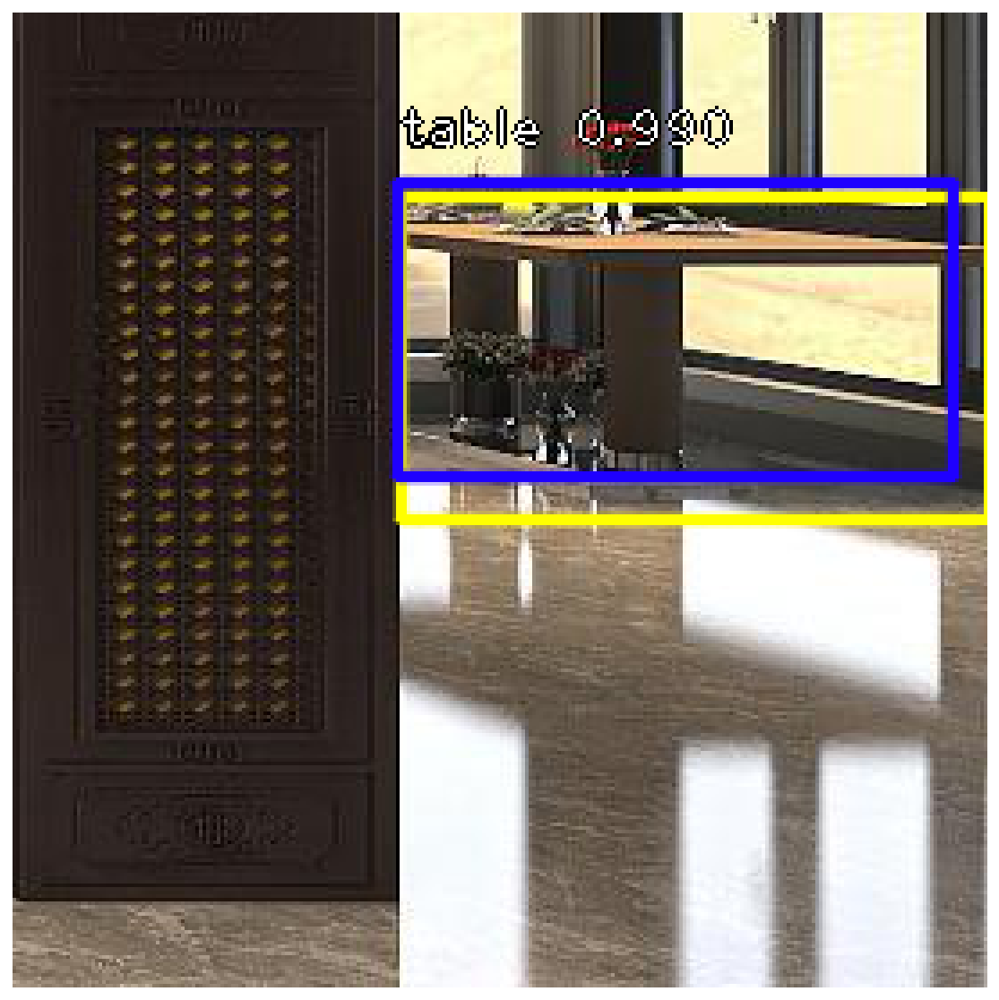

In [49]:

show_detected_objects(test_df.iloc[2])

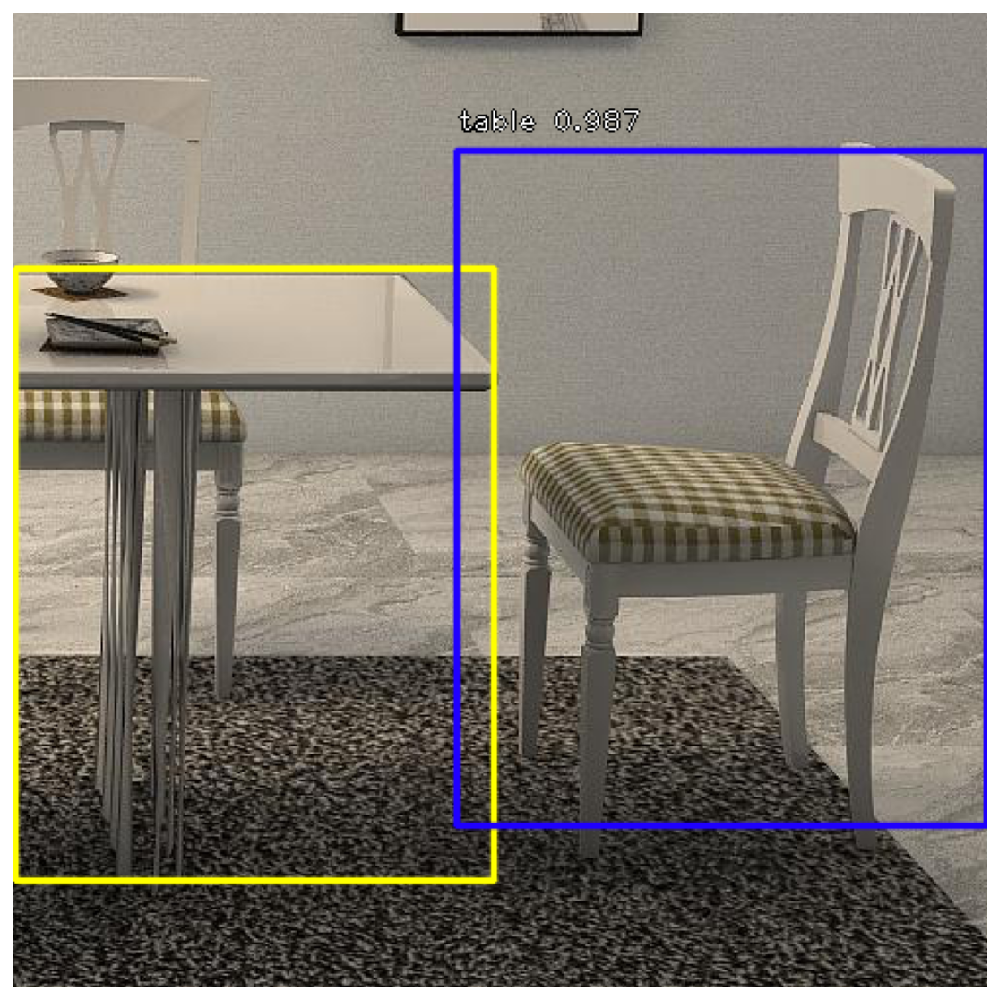

In [50]:
show_detected_objects(test_df.iloc[5])

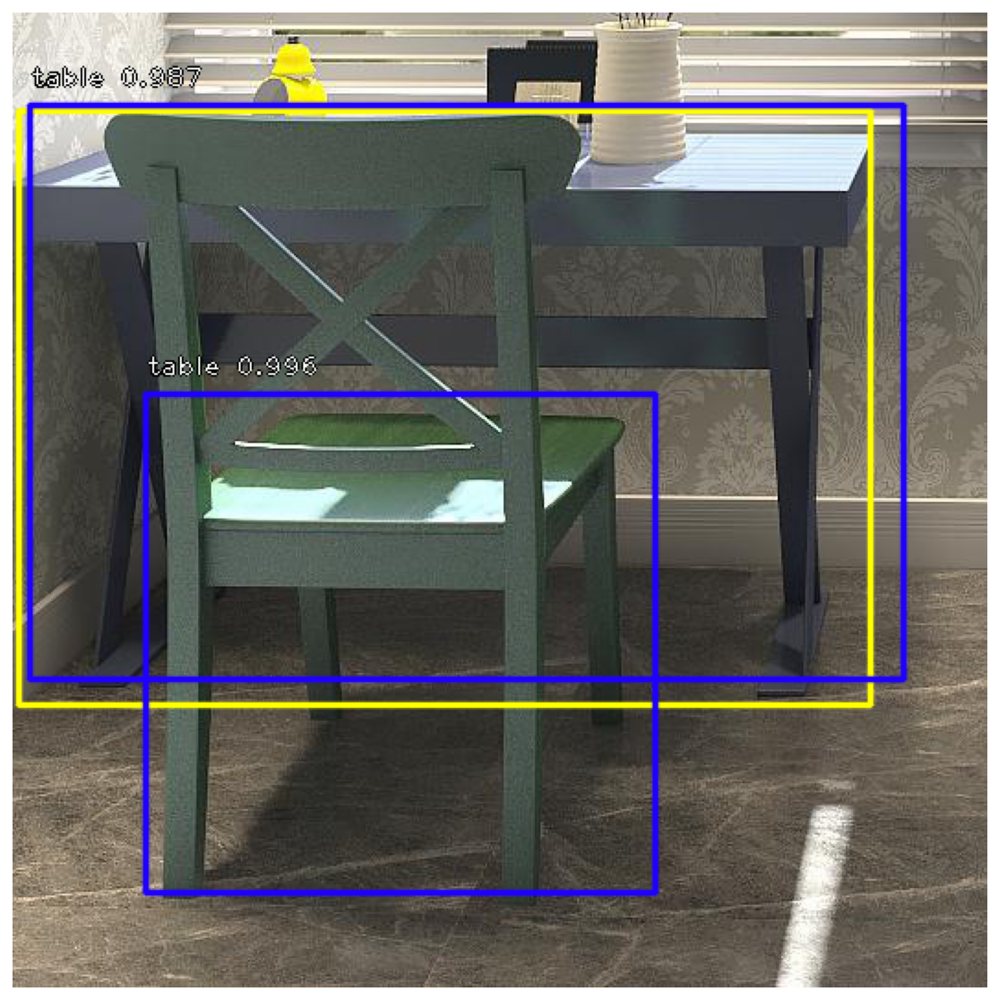

In [51]:
show_detected_objects(test_df.iloc[7])

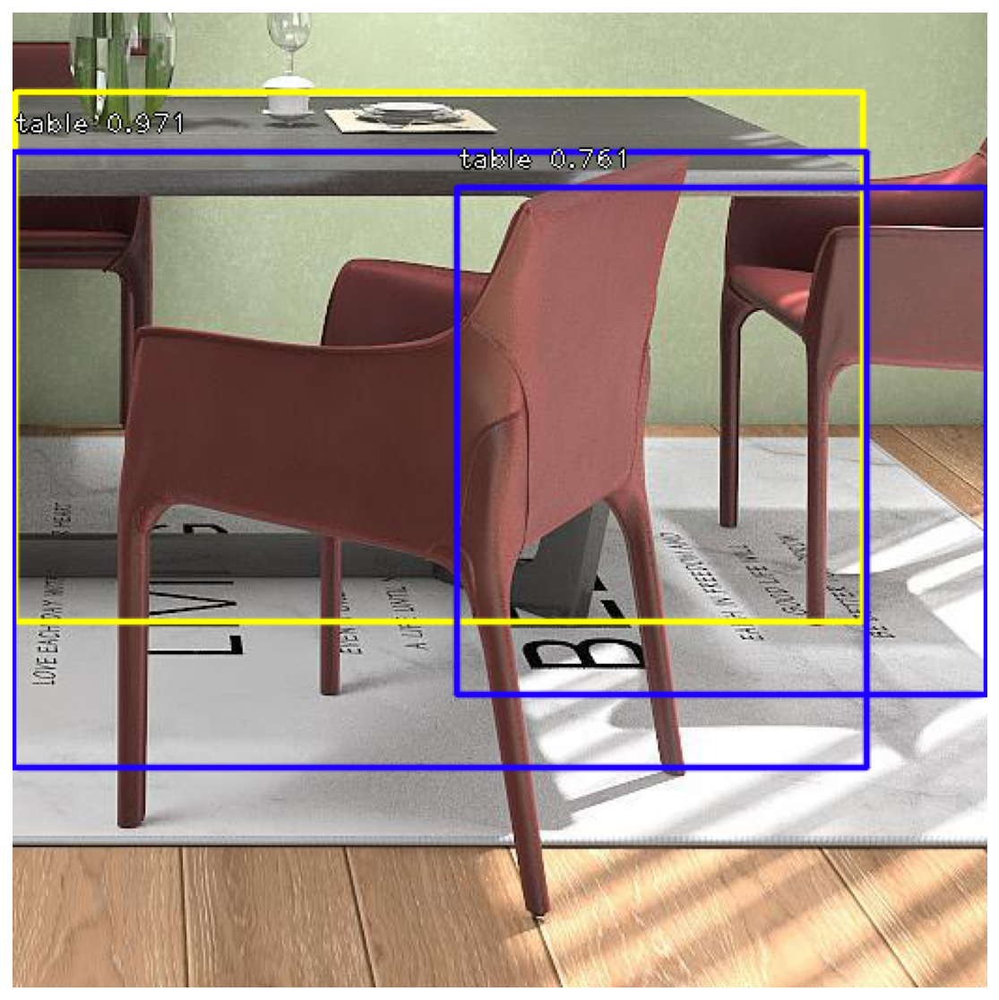

In [52]:
show_detected_objects(test_df.iloc[6])

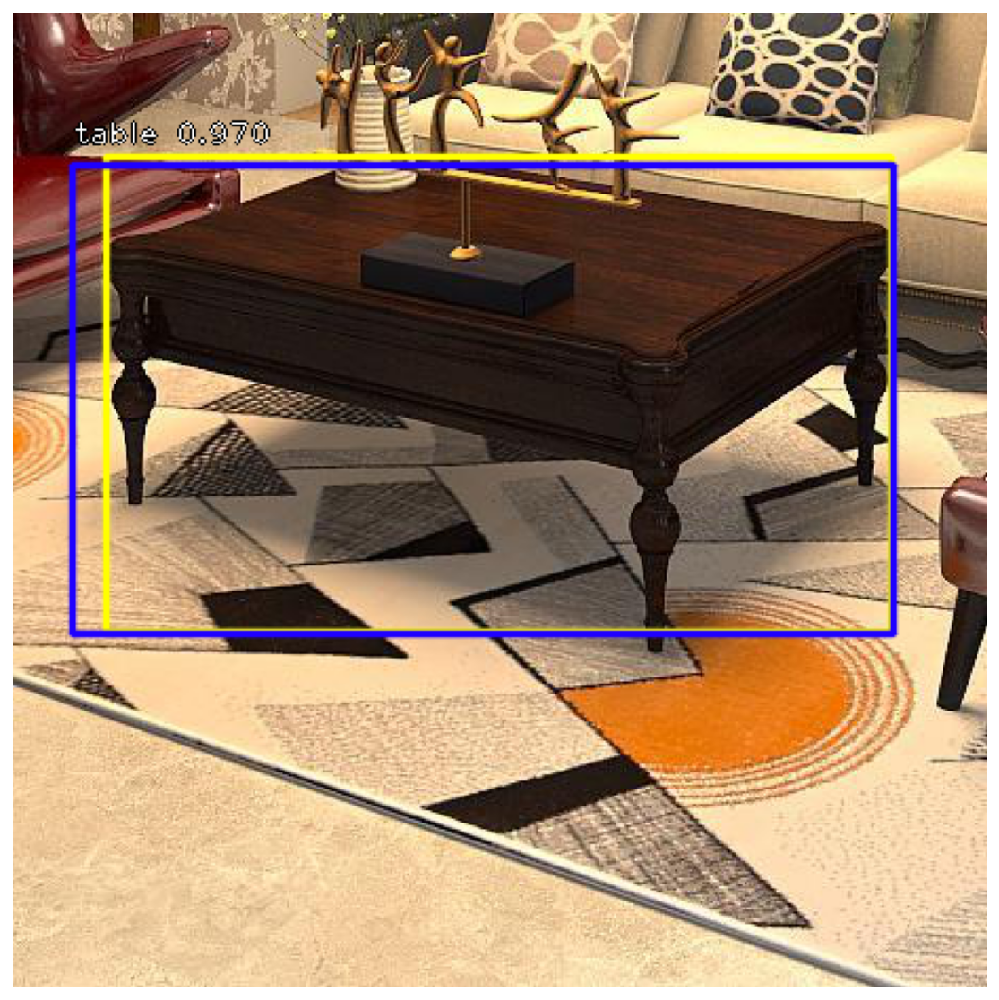

In [53]:
show_detected_objects(test_df.iloc[3])

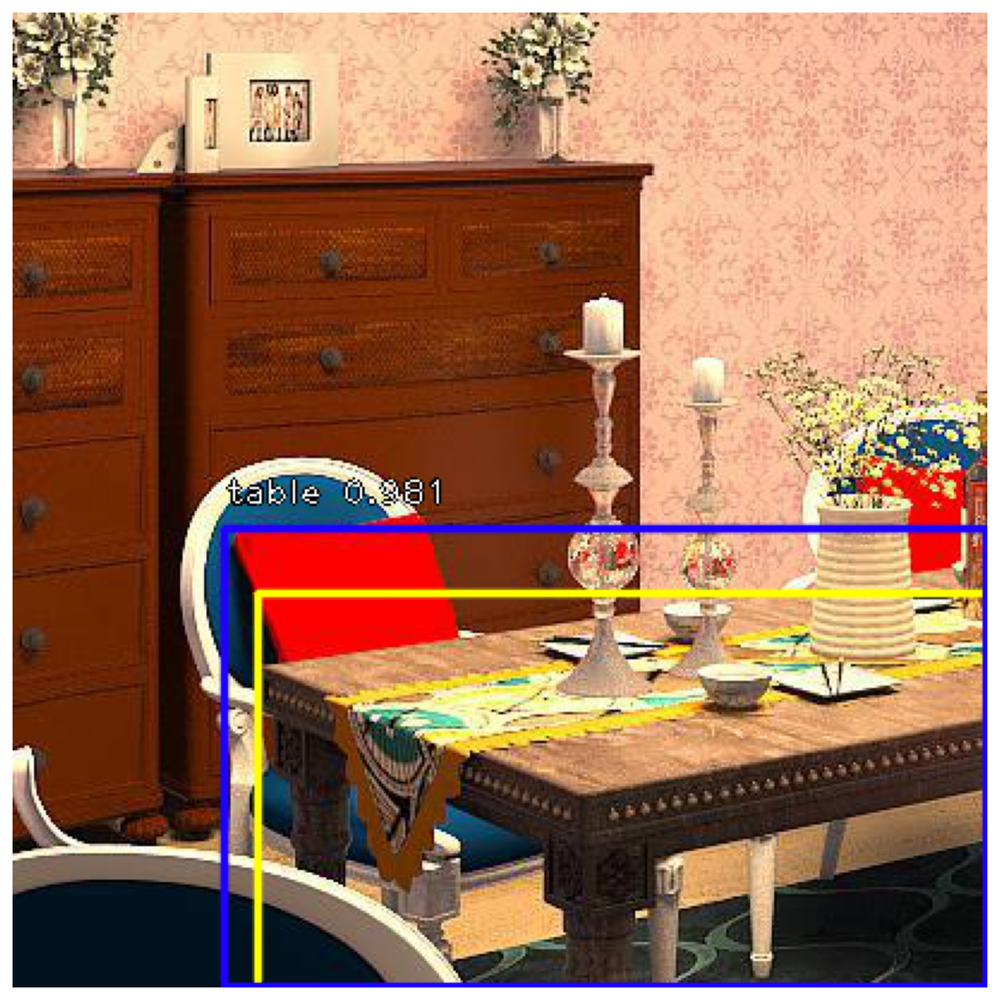

In [54]:
show_detected_objects(test_df.iloc[4])

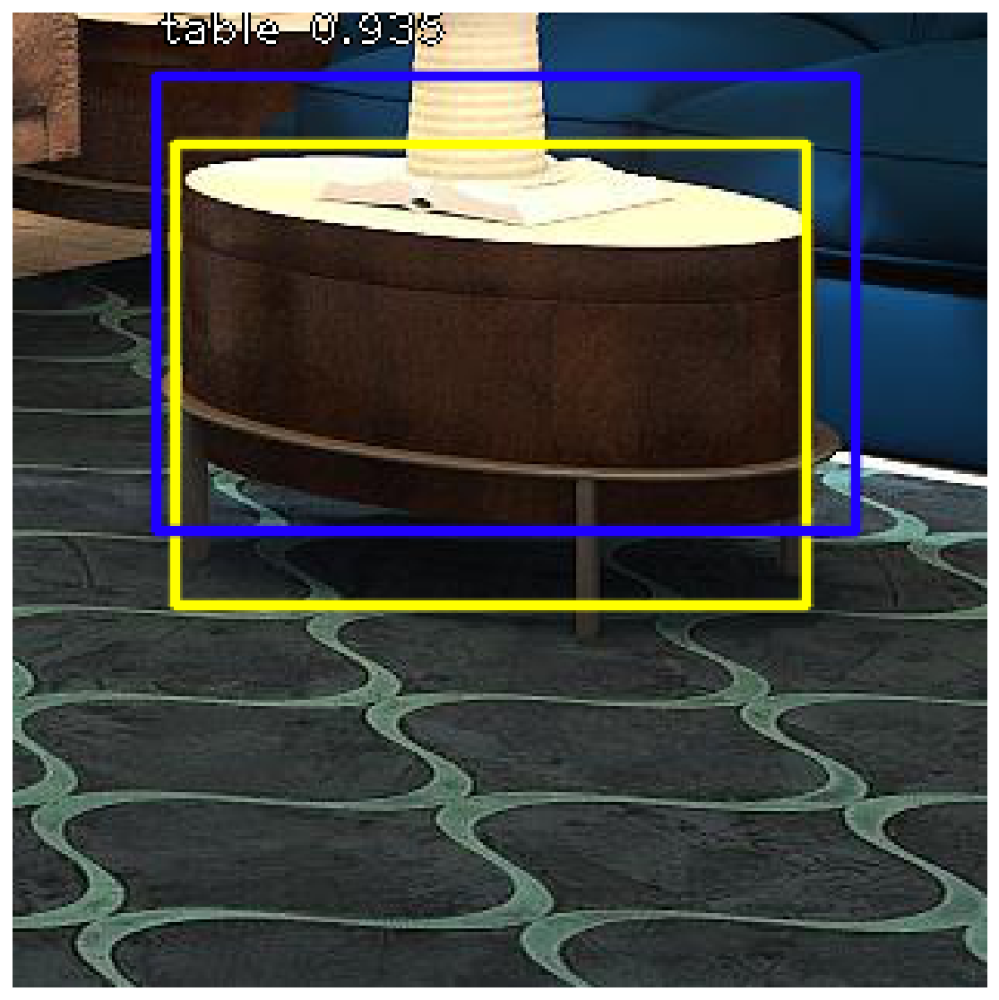

In [55]:
show_detected_objects(test_df.iloc[19])

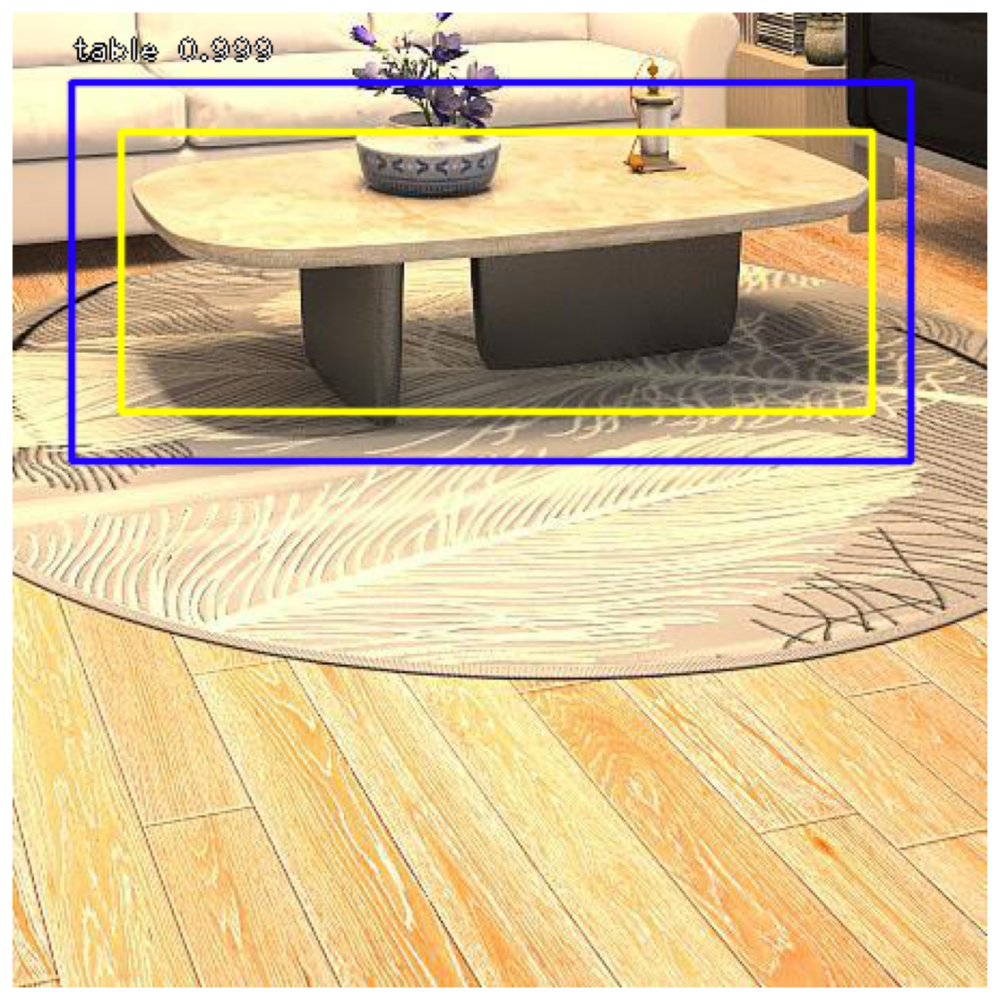

In [56]:
show_detected_objects(test_df.iloc[25])

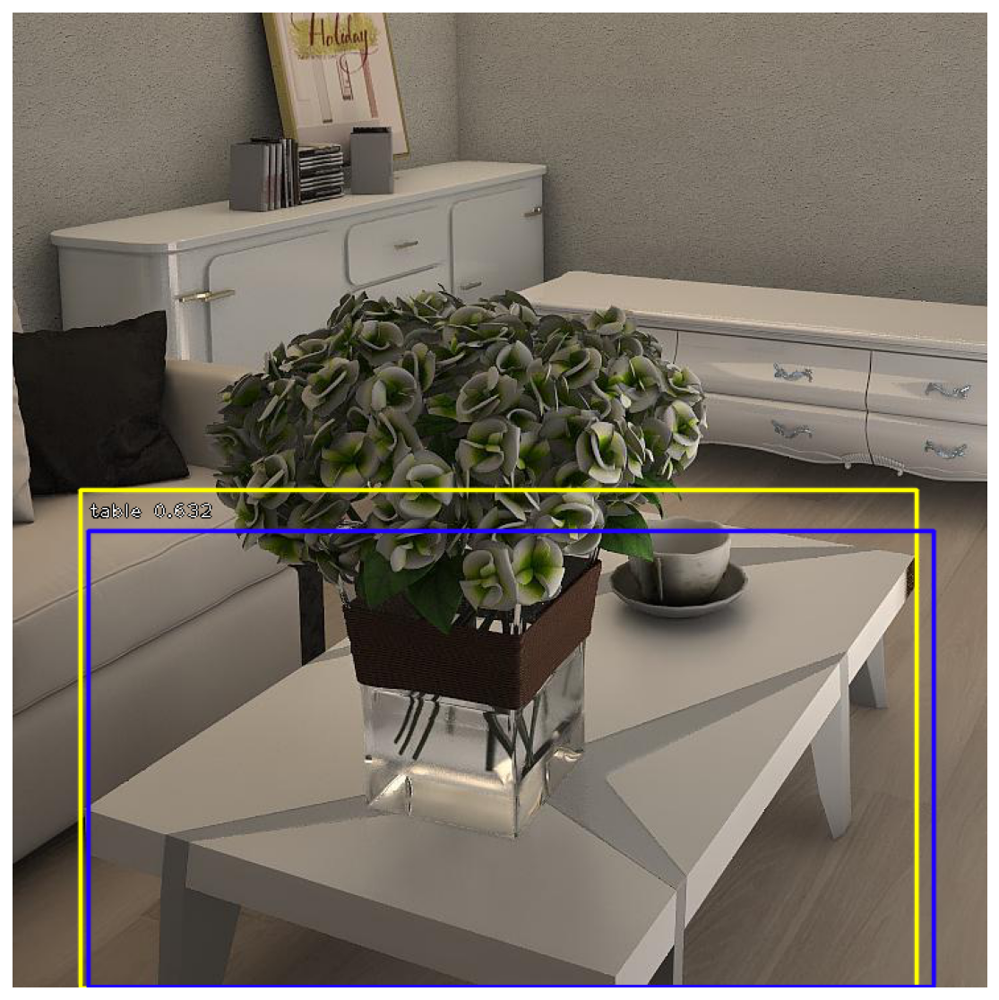

In [57]:
show_detected_objects(test_df.iloc[16])

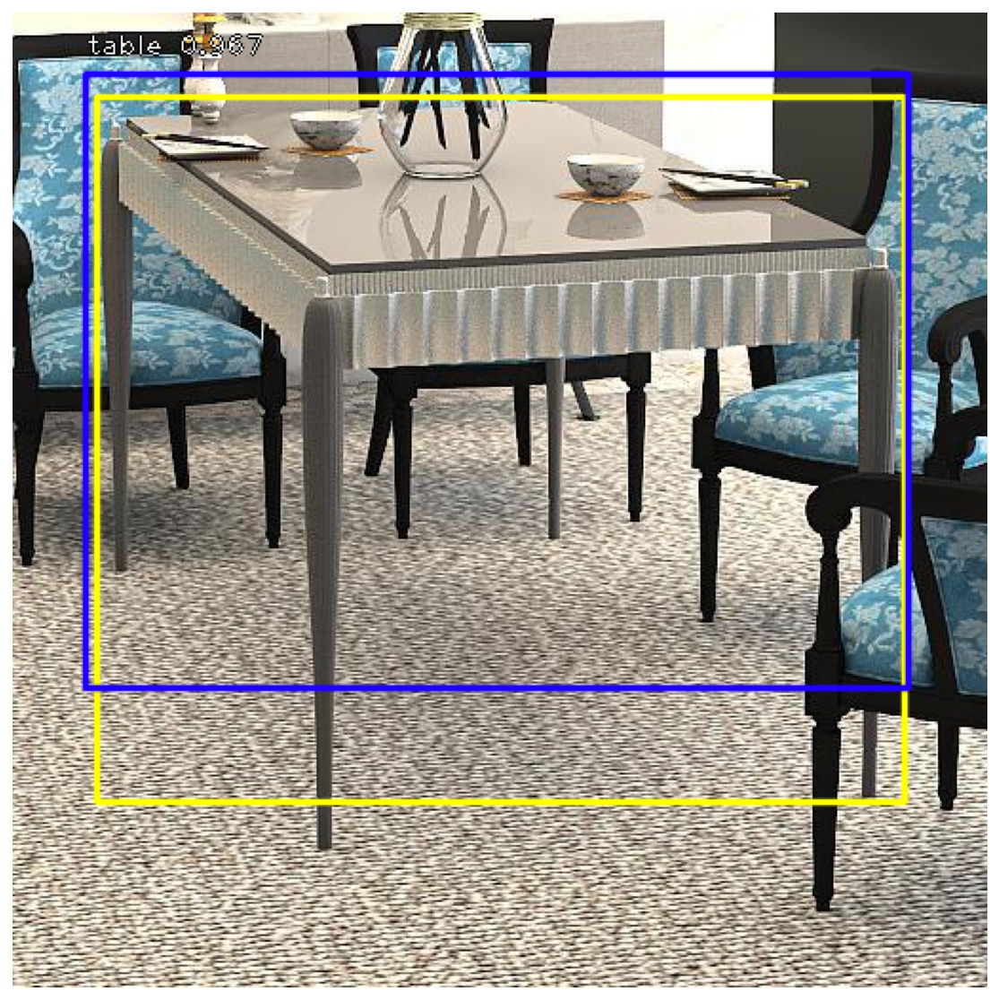

In [58]:
show_detected_objects(test_df.iloc[20])

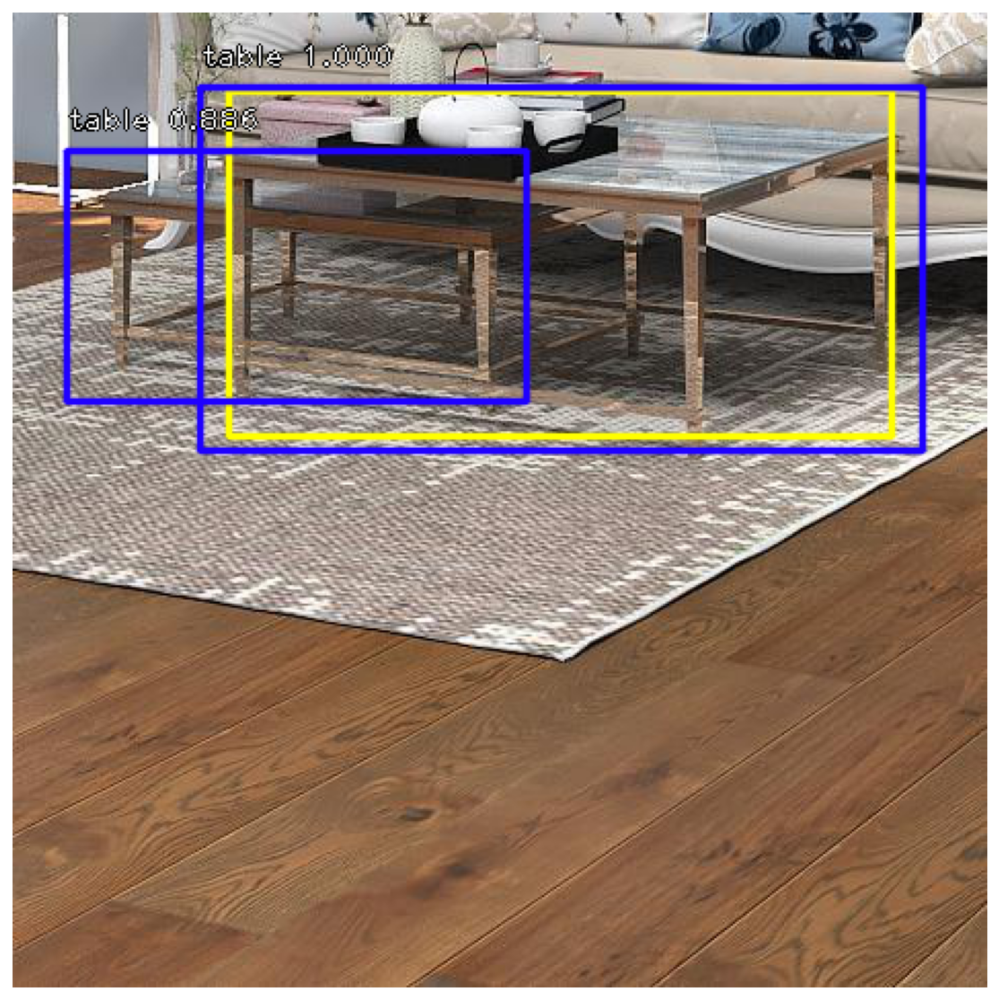

In [59]:
show_detected_objects(test_df.iloc[13])

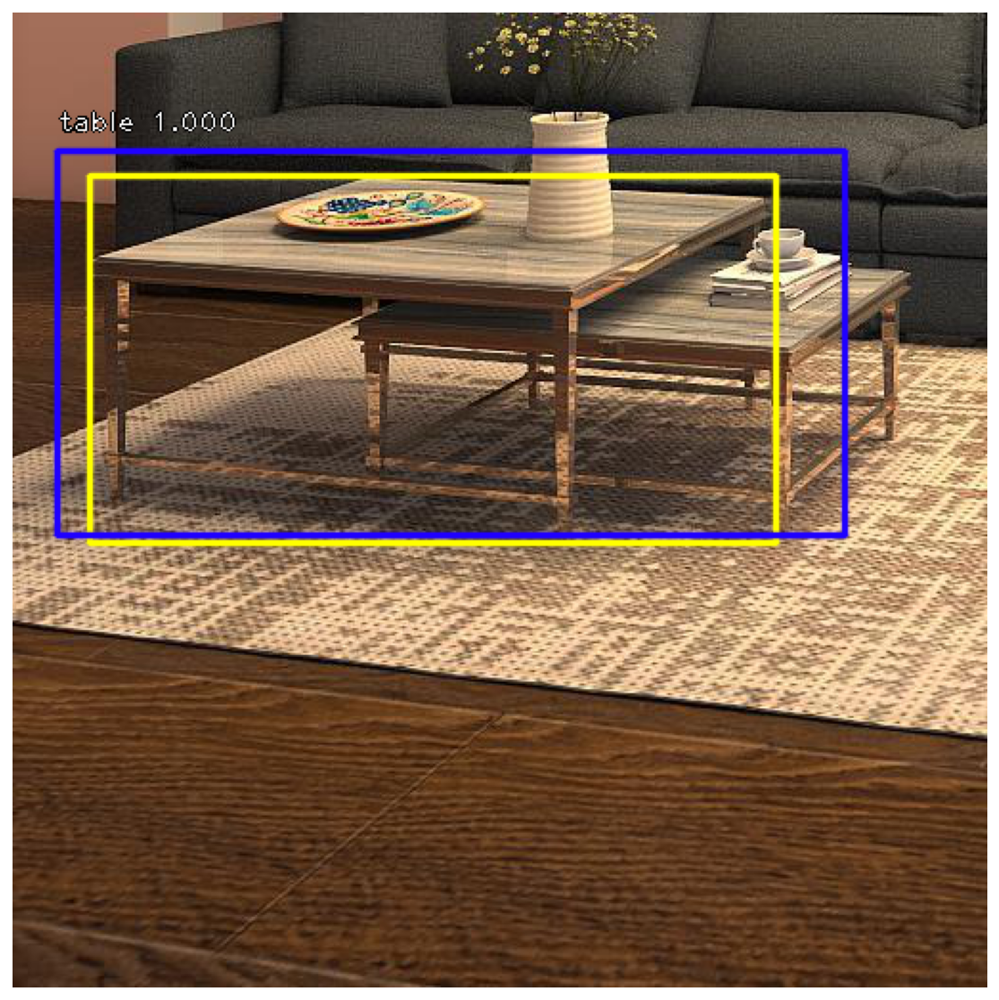

In [60]:
show_detected_objects(test_df.iloc[10])

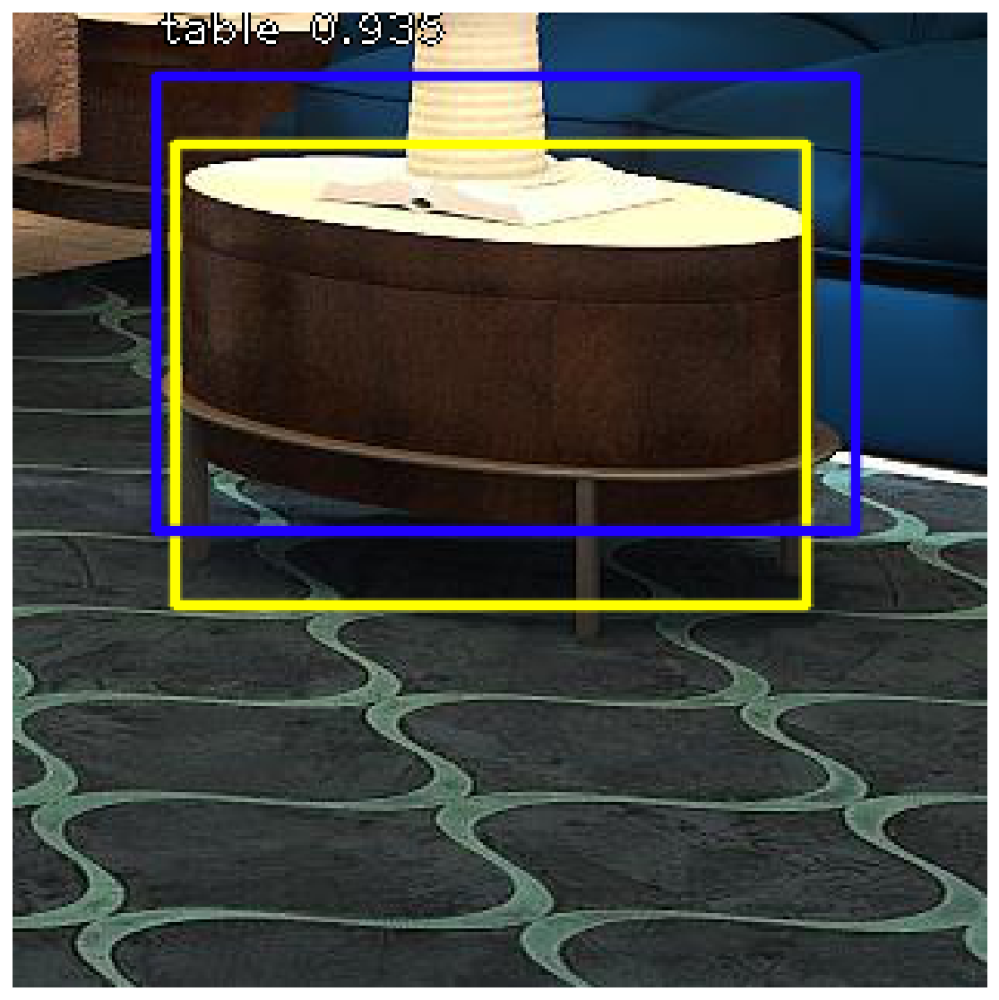

In [61]:
show_detected_objects(test_df.iloc[19])